In [1]:
import geopandas as gpd
from folium import (
    LayerControl,
    Element,
    TileLayer,
)
import plotly.express as px




from core.downloads.geosampa import get_capabilities, get_features

# Promoção da Sustentabilidade Ambiental, Gestão de risco

## Formulário 7

O formulário associado a este notebook solicita os dados sobre 
`áreas de risco (hidrológico e deslizamentos)`. A justificativa para estes dados é a seguinte:

> As áreas de risco estão relacionadas à construção de moradias, em sua maioria em condições precárias, em locais com geológico-geotécnicas frágeis, não recomendadas para ocupação. O impacto de chuvas concentradas intensas, características de eventos climáticos extremos deve ser monitorado pelo Município, através de políticas públicas de gestão de risco e promoção da resiliência climática.

In [2]:
get_capabilities('hidrológico')

[{'name': 'geoportal:risco_hidrologico',
  'title': 'Risco Hidrológico',
  'abstract': 'Áreas de risco de enchentes e inundações em assentamentos precários.'}]

In [3]:
get_capabilities('deslizamento')

[{'name': 'geoportal:risco_ocorrencia_deslizamento',
  'title': 'Deslizamento',
  'abstract': 'Deslizamento.'},
 {'name': 'geoportal:area_risco_geologico',
  'title': 'Risco Geológico',
  'abstract': 'Polígonos que delimitam as áreas de risco geológico em assentamentos precários, sujeitas a deslizamentos e solapamento de margem de córrego no Município de São Paulo levantadas pelo IPT/SMSP entre 2009 e 2011.'},
 {'name': 'geoportal:risco_ocorrencia_risco_deslizamento',
  'title': 'Risco de Deslizamento',
  'abstract': 'Risco de deslizamento.'}]

Como o formulário cita apenas a camada `proteção e defesa civil/mapeamento de areas de risco`, assumirei que a referência a deslizamentos seja sobre a camada de risco geológico.

In [4]:
df_hid = get_features('geoportal:risco_hidrologico')
df_hid.head()

,id,cd_identificador_risco_hidrologico,nm_area_risco_hidrologico,tx_grau_risco_hidrologico,sg_area_risco_hidrologico,sg_setor_risco_hidrologico,tx_tipo_processo,dt_vistoria,qt_moradia,nm_subprefeitura,nm_bacia_hidrografica,geometry
0,risco_hidrologico.1,1,BARTOLOMEU FEIO,R2,HPI-01,HPI-01-01 (R2),ALAGAMENTO,2021-08-24,44,PINHEIROS,CORREGO AGUA ESPRAIADA,"POLYGON ((327424.845 7387319.281, 327417.205 7..."
1,risco_hidrologico.726,726,PARQUE SAO JOSE VI,R2,HCS-12,HCS-12-02 (R2),ENCHENTE/INUNDACAO/ALAGAMENTO,2023-12-06,10,CAPELA DO SOCORRO,CORREGO SAO JOSE,"POLYGON ((326573.912 7373417.283, 326569.002 7..."
2,risco_hidrologico.742,742,PARQUE SANTA CECILIA,R2,HCS-20,HCS-20-02 (R2),ENCHENTE/INUNDACAO/ALAGAMENTO,2024-09-02,175,CAPELA DO SOCORRO,CORREGO REIMBERG COCAIA,"POLYGON ((327098.488 7371016.389, 327076.656 7..."
3,risco_hidrologico.670,670,VAZ DE LIMA,R3,HMB-33,HMB-33-02 (R3),ENCHENTE/INUNDAÇÃO,2025-01-14,50,M BOI MIRIM,CORREGO MORRO DO S,"POLYGON ((320306.959 7381219.451, 320299.705 7..."
4,risco_hidrologico.727,727,PARQUE SAO JOSE VI,R3,HCS-12,HCS-12-01 (R3),ENCHENTE,2023-12-06,240,CAPELA DO SOCORRO,CORREGO SAO JOSE,"POLYGON ((326521.673 7373391.903, 326521.358 7..."


In [5]:
df_geo = get_features('geoportal:area_risco_geologico')
df_geo.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,2022-02-02,18,0,"POLYGON ((332306.817 7380115.28, 332246.187 73..."
1,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,2022-02-02,18,3,"POLYGON ((332093.382 7380021.902, 332083.988 7..."
2,area_risco_geologico.3,3,AVENIDA SANTO AFONSO III,r1,AD-03,AD-03-01 (R1),ESCORREGAMENTO,2,1,2025-05-04 03:00:00+00:00,2022-02-02,18,80,"POLYGON ((332072.887 7379996.732, 332028.543 7..."
3,area_risco_geologico.4,4,RUA SAO BENTO XV,r3,AD-04,AD-04-03 (R3),SOLAPAMENTO,4,3,2025-05-04 03:00:00+00:00,2024-03-27,18,100,"POLYGON ((332324.725 7378882.633, 332309.159 7..."
4,area_risco_geologico.5,5,RUA SAO BENTO XV,r3,AD-04,AD-04-01 (R3),SOLAPAMENTO,4,3,2025-05-04 03:00:00+00:00,2024-03-27,18,30,"POLYGON ((332060.389 7379330.535, 332080.779 7..."


Além dos dados de riscos hidrogeológicos, também precisaremos dos dados do Censo de 2022 para a estimativa populacional. Os dados básicos, como número de domicílios e população, são disponibilizados diretamente no geopackage com as geometrias de setores censitários.

In [6]:
df_censo = gpd.read_file('https://ftp.ibge.gov.br/Censos/Censo_Demografico_2022/Agregados_por_Setores_Censitarios/malha_com_atributos/setores/gpkg/UF/SP/SP_setores_CD2022.gpkg')
df_censo.head()

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
0,350010505000001,Urbana,1,0,0.123824,3,Sudeste,35,São Paulo,3500105,...,.,None,288,199,199,0,2.1,0.1667,138,"POLYGON ((-51.07255 -21.68865, -51.07237 -21.6..."
1,350010505000002,Urbana,1,0,0.202614,3,Sudeste,35,São Paulo,3500105,...,.,None,674,339,339,0,2.4,0.0143,280,"POLYGON ((-51.07378 -21.6862, -51.07388 -21.68..."
2,350010505000003,Urbana,1,0,0.235048,3,Sudeste,35,São Paulo,3500105,...,.,None,380,269,268,1,1.9,0.0404,198,"POLYGON ((-51.07138 -21.68313, -51.06965 -21.6..."
3,350010505000004,Urbana,1,0,0.288468,3,Sudeste,35,São Paulo,3500105,...,.,None,570,290,288,2,2.4,0.0127,236,"POLYGON ((-51.0688 -21.68808, -51.0673 -21.690..."
4,350010505000005,Urbana,1,0,0.213724,3,Sudeste,35,São Paulo,3500105,...,.,None,612,313,312,1,2.2,0.0404,272,"POLYGON ((-51.06969 -21.69442, -51.06928 -21.6..."


In [7]:
df_censo = df_censo.loc[df_censo['CD_MUN']=='3550308']
df_censo.head()

,CD_SETOR,SITUACAO,CD_SIT,CD_TIPO,AREA_KM2,CD_REGIAO,NM_REGIAO,CD_UF,NM_UF,CD_MUN,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
67060,355030801000001,Urbana,1,0,0.071797,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,682,329,329,0,2.4,0.0381,289,"POLYGON ((-46.56954 -23.56918, -46.57016 -23.5..."
67061,355030801000002,Urbana,1,0,0.071902,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,1374,1011,1011,0,2.3,0.0150,599,"POLYGON ((-46.56806 -23.56521, -46.56786 -23.5..."
67062,355030801000003,Urbana,1,0,0.055681,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,557,239,238,1,2.7,0.0927,205,"POLYGON ((-46.56619 -23.56605, -46.56632 -23.5..."
67063,355030801000004,Urbana,1,0,0.064905,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,526,245,245,0,2.4,0.0136,221,"POLYGON ((-46.56876 -23.56856, -46.56863 -23.5..."
67064,355030801000005,Urbana,1,0,0.086822,3,Sudeste,35,São Paulo,3550308,...,3550308,São Paulo/SP,579,258,258,0,2.6,0.0905,221,"POLYGON ((-46.57121 -23.57005, -46.57056 -23.5..."


## Ajustando as projeções

Vamos revisar os sistemas de coordenadas de todos os geodataframes para garantir que estão na mesma projeção.

In [8]:
for gdf in [df_geo, df_hid, df_censo]:
    print(gdf.columns[:5])
    print(gdf.crs)

Index(['id', 'cd_identificador', 'nm_area_risco', 'tx_grau_de_risco_geologico',
       'sg_area_risco'],
      dtype='object')
EPSG:31983
Index(['id', 'cd_identificador_risco_hidrologico', 'nm_area_risco_hidrologico',
       'tx_grau_risco_hidrologico', 'sg_area_risco_hidrologico'],
      dtype='object')
EPSG:31983
Index(['CD_SETOR', 'SITUACAO', 'CD_SIT', 'CD_TIPO', 'AREA_KM2'], dtype='object')
EPSG:4674


Como o geodataframe do censo está em outro crs, precisamos convertê-lo para o `epsg:31983`.

In [9]:
df_censo = df_censo.to_crs('EPSG:31983')

# Calculando a população de cada área de risco

Primeiro, vamos inspecionar visualmente os geodataframes.

In [10]:
df_geo.explore()

In [11]:
df_censo.iloc[:500].explore()

## Calculando as interseções

Depois, precisaremos calcular a interseção de cada um dos dataframes de risco com os setores censitários.

In [12]:
ol1 = gpd.overlay(df_geo, df_censo,
            how='intersection',
            keep_geom_type=True)
ol1.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,...,CD_CONCURB,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,3550308,São Paulo/SP,998,349,349,0,3.0,0.1737,334,"POLYGON ((332417.123 7380272.176, 332496.547 7..."
1,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,3550308,São Paulo/SP,847,314,314,0,3.0,0.0488,287,"POLYGON ((332246.187 7380127.313, 332265.747 7..."
2,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,3550308,São Paulo/SP,797,314,314,0,2.8,0.2570,284,"POLYGON ((332594.538 7380241.784, 332588.367 7..."
3,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,3550308,São Paulo/SP,444,175,175,0,2.9,0.0968,155,"POLYGON ((332402.081 7380279.497, 332404.369 7..."
4,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,3550308,São Paulo/SP,371,165,165,0,2.3,0.1304,161,"POLYGON ((332542.393 7380125.77, 332451.063 73..."


Vamos avaliar visualmente o resultado da interseção com base na primeira área de risco.

In [13]:
id_area = ol1.loc[:, 'id'].iloc[0]
id_area

'area_risco_geologico.1'

In [14]:
cd_setor_list = ol1.loc[ol1['id']==id_area, 'CD_SETOR'].tolist()
ol1.loc[ol1['id']=='area_risco_geologico.1', ['id', 'CD_SETOR']]

,id,CD_SETOR
0,area_risco_geologico.1,355030822000168
1,area_risco_geologico.1,355030822000171
2,area_risco_geologico.1,355030822000194
3,area_risco_geologico.1,355030822000492
4,area_risco_geologico.1,355030822000524
5,area_risco_geologico.1,355030822000617
6,area_risco_geologico.1,355030822000618


In [15]:
m = df_censo[df_censo['CD_SETOR'].isin(
    cd_setor_list)].explore(name='setor censitário')

m = df_geo[df_geo['id'] == 'area_risco_geologico.1'].explore(
    m=m, color='orange', name='area de risco')

filtered_ol1 = ol1.loc[ol1['id'] == 'area_risco_geologico.1', [
    'id', 'CD_SETOR', 'geometry']]
m = filtered_ol1.explore(m=m, color='purple', name='interseção')

LayerControl().add_to(m)

m

Na inspeção visual, nota-se que algumas interseções não aparentam representar áreas com moradias, mas simplesmente leves discrepâncias no desenho dos polígonos sobre áreas não populadas (ruas,  canteiros, etc.).

Por isso, precisaremos limpar essas interseções da nossa base. Podemos utilizar um buffer negativo nos polígonos, de modo que polígonos com altura/largura menor do que a metade do valor aplicado no buffer se tornarão vazios.

## Removendo interseções não significantes

In [16]:
# Assumindo que um terreno com 8m ou menos de largura não possui uma casa
buffer = -1*(8/2)

ol2 = ol1.copy()
ol2['debuffed'] = ol2.buffer(buffer)
ol2 = ol2[~ol2['debuffed'].is_empty]
ol2.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,...,NM_CONCURB,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry,debuffed
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,São Paulo/SP,998,349,349,0,3.0,0.1737,334,"POLYGON ((332417.123 7380272.176, 332496.547 7...","POLYGON ((332415.372 7380268.58, 332415.719 73..."
2,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,São Paulo/SP,797,314,314,0,2.8,0.2570,284,"POLYGON ((332594.538 7380241.784, 332588.367 7...","POLYGON ((332590.234 7380238.463, 332584.541 7..."
5,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,São Paulo/SP,364,138,138,0,2.9,0.0720,125,"POLYGON ((332400.438 7380278.994, 332404.369 7...","POLYGON ((332367.746 7380264.79, 332367.339 73..."
6,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,São Paulo/SP,452,176,176,0,3.0,0.0523,153,"POLYGON ((332252.3 7380126.1, 332255.108 73801...","POLYGON ((332256.876 7380129.27, 332259.054 73..."
9,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,...,São Paulo/SP,462,226,226,0,2.7,0.1176,170,"POLYGON ((332084.691 7380033.042, 332084.229 7...","POLYGON ((332088.487 7380034.679, 332088.263 7..."


In [17]:
m = df_censo[df_censo['CD_SETOR'].isin(
    cd_setor_list)].explore(name='setor censitário')

m = df_geo[df_geo['id'] == 'area_risco_geologico.1'].explore(
    m=m, color='orange', name='area de risco')

filtered_ol2 = ol2.loc[ol2['id'] == 'area_risco_geologico.1', [
    'id', 'CD_SETOR', 'geometry']]
m = filtered_ol2.explore(m=m, color='purple', name='interseção')

LayerControl().add_to(m)

m

Vimos que as inteseções indesejadas sumiram do resultado, então podemos continuar os cálculos.

## Calculando a proporção das áreas

O primeiro passo é calcular a proporção entre a área da interseção e a área do setor censitário.

In [18]:
ol2['inter_area'] = ol2['geometry'].area
ol2.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,...,v0001,v0002,v0003,v0004,v0005,v0006,v0007,geometry,debuffed,inter_area
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,998,349,349,0,3.0,0.1737,334,"POLYGON ((332417.123 7380272.176, 332496.547 7...","POLYGON ((332415.372 7380268.58, 332415.719 73...",15906.137158
2,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,797,314,314,0,2.8,0.2570,284,"POLYGON ((332594.538 7380241.784, 332588.367 7...","POLYGON ((332590.234 7380238.463, 332584.541 7...",11424.844359
5,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,364,138,138,0,2.9,0.0720,125,"POLYGON ((332400.438 7380278.994, 332404.369 7...","POLYGON ((332367.746 7380264.79, 332367.339 73...",4007.234487
6,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,452,176,176,0,3.0,0.0523,153,"POLYGON ((332252.3 7380126.1, 332255.108 73801...","POLYGON ((332256.876 7380129.27, 332259.054 73...",6929.718843
9,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,...,462,226,226,0,2.7,0.1176,170,"POLYGON ((332084.691 7380033.042, 332084.229 7...","POLYGON ((332088.487 7380034.679, 332088.263 7...",262.351599


In [19]:
df_censo_area = df_censo[['CD_SETOR', 'geometry']]
df_censo_area['area_setor'] = df_censo_area['geometry'].area
df_censo_area

C:\Users\855395\Git\dados-painel\.venv\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,CD_SETOR,geometry,area_setor
67060,355030801000001,"POLYGON ((339819.408 7392592.742, 339756.894 7...",71784.754804
67061,355030801000002,"POLYGON ((339965.621 7393034.24, 339986.558 73...",71889.823157
67062,355030801000003,"POLYGON ((340157.888 7392942.284, 340144.598 7...",55671.820654
67063,355030801000004,"POLYGON ((339898.255 7392661.983, 339912.255 7...",64894.157036
67064,355030801000005,"POLYGON ((339650.83 7392494.454, 339716.68 739...",86807.417754
...,...,...,...
94356,355030896000345,"POLYGON ((354324.092 7397531.959, 354328.672 7...",72173.766291
94357,355030896000346,"POLYGON ((354539.073 7397602.478, 354530.75 73...",30590.900583
94358,355030896000347,"POLYGON ((358000.653 7397497.126, 357886.748 7...",21130.434214
94359,355030896000348,"POLYGON ((357912.856 7397411.072, 357783.427 7...",31952.498869


In [ ]:
ol2 = ol2.merge(df_censo_area[['CD_SETOR', 'area_setor']], how='left',
          on='CD_SETOR')
ol2.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,...,v0002,v0003,v0004,v0005,v0006,v0007,geometry,debuffed,inter_area,area_setor
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,349,349,0,3.0,0.1737,334,"POLYGON ((332417.123 7380272.176, 332496.547 7...","POLYGON ((332415.372 7380268.58, 332415.719 73...",15906.137158,16330.096642
1,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,314,314,0,2.8,0.2570,284,"POLYGON ((332594.538 7380241.784, 332588.367 7...","POLYGON ((332590.234 7380238.463, 332584.541 7...",11424.844359,12869.009639
2,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,138,138,0,2.9,0.0720,125,"POLYGON ((332400.438 7380278.994, 332404.369 7...","POLYGON ((332367.746 7380264.79, 332367.339 73...",4007.234487,7576.459769
3,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,176,176,0,3.0,0.0523,153,"POLYGON ((332252.3 7380126.1, 332255.108 73801...","POLYGON ((332256.876 7380129.27, 332259.054 73...",6929.718843,8797.067707
4,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,...,226,226,0,2.7,0.1176,170,"POLYGON ((332084.691 7380033.042, 332084.229 7...","POLYGON ((332088.487 7380034.679, 332088.263 7...",262.351599,9667.943370


In [ ]:
ol2['prop_setor'] = ol2['inter_area']/ol2['area_setor']
ol2.head()

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,...,v0003,v0004,v0005,v0006,v0007,geometry,debuffed,inter_area,area_setor,prop_setor
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,349,0,3.0,0.1737,334,"POLYGON ((332417.123 7380272.176, 332496.547 7...","POLYGON ((332415.372 7380268.58, 332415.719 73...",15906.137158,16330.096642,0.974038
1,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,314,0,2.8,0.2570,284,"POLYGON ((332594.538 7380241.784, 332588.367 7...","POLYGON ((332590.234 7380238.463, 332584.541 7...",11424.844359,12869.009639,0.887780
2,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,138,0,2.9,0.0720,125,"POLYGON ((332400.438 7380278.994, 332404.369 7...","POLYGON ((332367.746 7380264.79, 332367.339 73...",4007.234487,7576.459769,0.528906
3,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,...,176,0,3.0,0.0523,153,"POLYGON ((332252.3 7380126.1, 332255.108 73801...","POLYGON ((332256.876 7380129.27, 332259.054 73...",6929.718843,8797.067707,0.787731
4,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,...,226,0,2.7,0.1176,170,"POLYGON ((332084.691 7380033.042, 332084.229 7...","POLYGON ((332088.487 7380034.679, 332088.263 7...",262.351599,9667.943370,0.027136


Sabendo que a proporção da interseção não deve ser maior do que 1, vamos conferir os valores de interseção.

<Axes: >

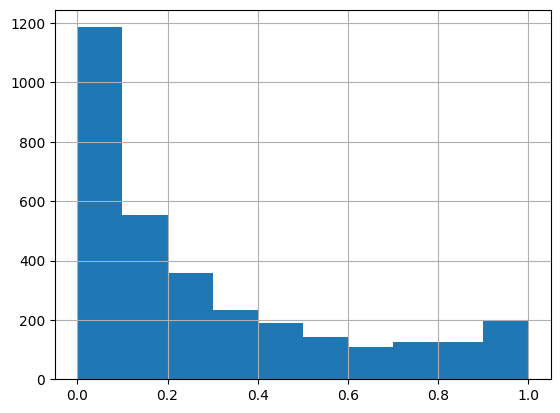

In [22]:
ol2['prop_setor'].hist()

Como a distribuição apresenta muitos valores abaixo de 0.2, vamos analisar esses casos visualmente para confirmar que fazem sentido.

In [23]:
filtro_intersecoes_pequenas = ol2['prop_setor']<=0.2
setores_02 = ol2.loc[filtro_intersecoes_pequenas, 'CD_SETOR'].tolist()
areas_risco_02 = ol2.loc[filtro_intersecoes_pequenas, 'id'].tolist()

In [24]:
# Criar o mapa com as camadas
m = df_censo[df_censo['CD_SETOR'].isin(setores_02)].explore(name='Setor Censitário')

m = df_geo[df_geo['id'].isin(areas_risco_02)].explore(
    m=m, color='orange', name='Área de Risco')

filtered_ol2 = ol2.loc[filtro_intersecoes_pequenas, ['id', 'CD_SETOR', 'geometry', 'prop_setor']]
m = filtered_ol2.explore(m=m, color='purple', name='Interseção')

LayerControl().add_to(m)

# Adicionar a legenda personalizada
legend_html = """
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: 120px; 
            background-color: white; z-index:1000; padding: 10px; 
            border: 2px solid grey; border-radius: 5px;">
    <h4>Legenda</h4>
    <i style="background: orange; width: 10px; height: 10px; display: inline-block;"></i> Área de Risco<br>
    <i style="background: purple; width: 10px; height: 10px; display: inline-block;"></i> Interseção<br>
    <i style="background: blue; width: 10px; height: 10px; display: inline-block;"></i> Setor Censitário
</div>
"""
m.get_root().html.add_child(Element(legend_html))

m

A inspeção visual mostra que as interseções aparentam ser significativas, mas se tratam de interseções pequenas em comparação com os setores censitários, ocorrendo principalmente em setores sensitários maiores. Portanto, a eliminação das interseções e o cálculo da proporção da população parece ter funcionado corretamente.

Porém, um ponto notado durante a inspeção visual e oportuno de destaque é um possível viés de superestimação em áreas pouco povoadas, como no entorno de parques. Por se tratarem de áreas de baixa densidade demográfica, estão mais sujeitas a estarem incluídas em setores censitários maiores e a uma distribuição heterogênea da população dentro do seu território. Um exemplo desse caso pode ser visto nas áreas de risco de cd_identificador 1227 a 1230.

## Calculando a população

O primeiro passo é calcular a população correspondente a cada interseção.

In [25]:
ol2['pop_estimada'] = ol2['v0001']*ol2['prop_setor']

(
    ol2
    .loc[:, ['id','CD_SETOR','v0001', 'prop_setor', 'pop_estimada']]
    .sort_values('pop_estimada', ascending=False)
)

,id,CD_SETOR,v0001,prop_setor,pop_estimada
481,area_risco_geologico.203,355030883000381,1152,0.943785,1087.240095
280,area_risco_geologico.120,355030894000179,1276,0.844400,1077.453819
274,area_risco_geologico.120,355030894000052,1188,0.884677,1050.995881
2361,area_risco_geologico.988,355030846000390,1082,0.968541,1047.961729
1979,area_risco_geologico.838,355030841000062,1042,0.996829,1038.695489
...,...,...,...,...,...
1013,area_risco_geologico.421,355030864000173,0,0.081667,0.000000
379,area_risco_geologico.161,355030817000611,0,0.146412,0.000000
2821,area_risco_geologico.1163,355030803000287,0,0.000990,0.000000
385,area_risco_geologico.163,355030817000611,0,0.336090,0.000000


Depois, calculamos a população agregada por área de risco.

In [26]:
area_risco_pop = (
    ol2
    .loc[:, ['id', 'pop_estimada']]
    .groupby('id')
    .sum()
    .round(0)
    .reset_index()
)

area_risco_pop['pop_estimada'] = area_risco_pop['pop_estimada'].astype(int)
area_risco_pop

,id,pop_estimada
0,area_risco_geologico.1,2228
1,area_risco_geologico.10,116
2,area_risco_geologico.100,385
3,area_risco_geologico.1000,194
4,area_risco_geologico.1001,348
...,...,...
1334,area_risco_geologico.995,51
1335,area_risco_geologico.996,137
1336,area_risco_geologico.997,147
1337,area_risco_geologico.998,1587


Finalmente, trazemos a coluna de população para o dataframe original.

In [27]:
df_geo_pop = df_geo.merge(
    area_risco_pop,
    how='left'
)

df_geo_pop

,id,cd_identificador,nm_area_risco,tx_grau_de_risco_geologico,sg_area_risco,sg_setor_risco,tx_tipo_processo_geologico,cd_tipo_processo_geologico,cd_grau_risco_geologico,dt_atualizacao,dt_vistoria,sg_fonte_original,qt_moradia,geometry,pop_estimada
0,area_risco_geologico.1,1,AVENIDA SANTO AFONSO I,AREA ENCERRADA,AD-01,AREA ENCERRADA,ESCORREGAMENTO,2,99,2025-05-04 03:00:00+00:00,2022-02-02,18,0,"POLYGON ((332306.817 7380115.28, 332246.187 73...",2228.0
1,area_risco_geologico.2,2,AVENIDA SANTO AFONSO III,r2,AD-03,AD-03-02 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,2022-02-02,18,3,"POLYGON ((332093.382 7380021.902, 332083.988 7...",13.0
2,area_risco_geologico.3,3,AVENIDA SANTO AFONSO III,r1,AD-03,AD-03-01 (R1),ESCORREGAMENTO,2,1,2025-05-04 03:00:00+00:00,2022-02-02,18,80,"POLYGON ((332072.887 7379996.732, 332028.543 7...",249.0
3,area_risco_geologico.4,4,RUA SAO BENTO XV,r3,AD-04,AD-04-03 (R3),SOLAPAMENTO,4,3,2025-05-04 03:00:00+00:00,2024-03-27,18,100,"POLYGON ((332324.725 7378882.633, 332309.159 7...",227.0
4,area_risco_geologico.5,5,RUA SAO BENTO XV,r3,AD-04,AD-04-01 (R3),SOLAPAMENTO,4,3,2025-05-04 03:00:00+00:00,2024-03-27,18,30,"POLYGON ((332060.389 7379330.535, 332080.779 7...",80.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1349,area_risco_geologico.1340,1340,PARQUE DAS FLORES IV,r4,SM-09,SM-09-05 (R4),ESCORREGAMENTO,2,4,2025-05-04 03:00:00+00:00,2024-11-13,18,70,"POLYGON ((352166.102 7384684.558, 352164.058 7...",261.0
1350,area_risco_geologico.1341,1341,MORUMBIZINHO,r3,SM-32,SM-32-01 (R3),ESCORREGAMENTO,2,3,2025-05-04 03:00:00+00:00,2024-11-13,18,20,"POLYGON ((351837.093 7385693.468, 351838.563 7...",38.0
1351,area_risco_geologico.1342,1342,VILA FLAVIA,r1,SM-16,SM-16-04 (R1),ESCORREGAMENTO/SOLAPAMENTO,3,1,2025-05-04 03:00:00+00:00,2025-04-15,18,365,"POLYGON ((348975.844 7389466.492, 348967.659 7...",1137.0
1352,area_risco_geologico.1343,1343,VILA FLAVIA,r2,SM-16,SM-16-03 (R2),ESCORREGAMENTO,2,2,2025-05-04 03:00:00+00:00,2025-04-15,18,175,"POLYGON ((348997.672 7389443.227, 348998.682 7...",450.0


# Visualizando a população

Para visualizar o resultado, vamos criar algumas visualizações. Primeiro, vamos criar dois *treemaps* por tipo de processo e grau de risco, alterando a ordem da hierarquia.

In [28]:
df_tree = (
    df_geo_pop
    .groupby(['tx_tipo_processo_geologico', 'tx_grau_de_risco_geologico'], as_index=False)
    ['pop_estimada']
    .sum()
)

df_tree

,tx_tipo_processo_geologico,tx_grau_de_risco_geologico,pop_estimada
0,ESCORREGAMENTO,AREA ENCERRADA,7893.0
1,ESCORREGAMENTO,r1,67644.0
2,ESCORREGAMENTO,r2,163323.0
3,ESCORREGAMENTO,r3,40218.0
4,ESCORREGAMENTO,r4,13087.0
5,ESCORREGAMENTO/SOLAPAMENTO,AREA ENCERRADA,45.0
6,ESCORREGAMENTO/SOLAPAMENTO,r1,18163.0
7,ESCORREGAMENTO/SOLAPAMENTO,r2,21223.0
8,ESCORREGAMENTO/SOLAPAMENTO,r3,3182.0
9,ESCORREGAMENTO/SOLAPAMENTO,r4,3358.0


In [29]:
# Criar o gráfico do tipo treeview
fig = px.treemap(
    df_tree,
    path=['tx_grau_de_risco_geologico', 'tx_tipo_processo_geologico'],  # Caminho hierárquico
    values='pop_estimada',               # Valores para o tamanho das caixas
    title='Somatório de População Estimada por Tipo de Processo Geológico'
)

# Exibir o gráfico
fig.show()

In [30]:
# Criar o gráfico do tipo treeview
fig = px.treemap(
    df_tree,
    path=['tx_tipo_processo_geologico', 'tx_grau_de_risco_geologico'],  # Caminho hierárquico
    values='pop_estimada',               # Valores para o tamanho das caixas
    title='Somatório de População Estimada por Tipo de Processo Geológico'
)

# Exibir o gráfico
fig.show()

Por último, vamos criar um mapa coroplético das áreas de risco, adicionando as camadas de setores censitários envolvidos, interseções envolvidas (e população atribuida) e adicionar também uma camada de satelite.

In [31]:
# Criar o mapa base
m = df_geo_pop.explore(
    column='pop_estimada',  # Coluna para o mapa coroplético
    cmap='YlOrRd',          # Paleta de cores
    legend=True,            # Adicionar legenda
    tooltip=['tx_grau_de_risco_geologico', 'tx_tipo_processo_geologico', 'pop_estimada'],  # Informações no tooltip
    tiles='CartoDB positron',  # Mapa base
    name='Áreas de Risco'   # Nome da camada
)

# Filtrar os setores censitários presentes em ol2
setores_presentes = df_censo[df_censo['CD_SETOR'].isin(ol2['CD_SETOR'].unique())]

# Adicionar os setores censitários ao mapa
m = setores_presentes.explore(
    m=m,
    color='blue',
    name='Setores Censitários'
)

# Adicionar outra camada base (Google Satellite)
TileLayer(
    tiles='https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}',
    attr='Google Satellite',
    name='Google Satellite'
).add_to(m)

# Adicionar controle de camadas
LayerControl(position='bottomleft').add_to(m)

# Exibir o mapa
m
